In [3]:
import pandas as pd
import numpy as np
import nltk

from sklearn.feature_selection import SelectKBest, chi2, mutual_info_classif
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import LinearSVC, NuSVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from nltk.stem import WordNetLemmatizer
from sklearn.metrics import recall_score, precision_score, f1_score

from data import source_wsl, output	
from util import stat
from util import Pipeline, text
from util.model import Model, Sample

text_preprocess = Pipeline.from_config({
	'replace emoji': [text.replace_emoji],
	'remove retweet symbol': [text.remove_retweet],
	'remove url': [(text.remove_pattern, text.PATTERN['url'])],
	'remove punctuation': [(text.remove_pattern, text.PATTERN['slight punc'])],  # ATTENTION: it will remove @ #
	'to lower': [str.lower],
	'remove _': [(text.replace_pattern, r'_', ' ')],
	'tokenize': [nltk.tokenize.word_tokenize],
	'lemmatize': [text.lemmatize],
	'remove stopwords': [(text.remove_stopwords, text.STOP_WORDS + ['amp'])],
})[0]

def process(tweets: pd.Series, pipeline):
	return pd.Series([pipeline(tweet) for tweet in tweets.to_numpy()])

def flatten(tokens_list: pd.Series | np.ndarray):
	tokens_list = list(tokens_list)
	return [" ".join(tokens) for tokens in tokens_list]

def train_test(model: Model, sample: Sample):
	x_test, y_test = sample.pop_test(100, {0: 0.25, 1: 0.25, 2: 0.5})
	model.train(flatten(sample.x), sample.y, validate_size=0.2)
	y_pred = model.predict(flatten(x_test))
	model.evaluate(y_true=y_test, y_pred=y_pred)
	

def train_test2(model: Model, sample: Sample):
	x_test, y_test = sample.pop_test(100, {0: 0.25, 1: 0.25, 2: 0.5})
	model.train(flatten(sample.x[:, 0]), sample.y, validate_size=0.2, extra_features=sample.x[:, 1:],
				to_json='extra feature train')
	
	y_pred = model.predict(flatten(x_test[:, 0]), extra_features=x_test[:, 1:])
	model.evaluate(y_true=y_test, y_pred=y_pred, to_json='extra feature eval')

def train_test3(model: Model, sample: Sample):
	x_test, y_test = sample.pop_test(100, {0: 0.25, 1: 0.25, 2: 0.5})
	features = model.fit_transform(flatten(sample.x), sample.y)
	x_train, y_train = sample.from_cluster(features, sample.y, n_cluster=6000, use_centroid=False)
	model.classifier.fit(x_train, y_train)
	model.evaluate(y_train, model.classifier.predict(x_train), to_json='clustered train')
	model.evaluate(y_test, model.predict(flatten(x_test)), to_json='cluster eval')

In [2]:
# data = pd.read_csv(source_wsl)
# 
# data['num_at'] = data['tweet'].apply(stat.count_at)
# data['num_url'] = data['tweet'].apply(stat.count_url)
# data['num_hashtag'] = data['tweet'].apply(stat.count_hashtag)
# data['num_retweet'] = data['tweet'].apply(stat.count_retweet)
# 
# data['num_exclamation'] = data['tweet'].apply(stat.count_pattern, args=('!',))
# data['num_uppercase_word'] = data['tweet'].apply(stat.count_uppercase_word)
# data['num_lowercase_word'] = data['tweet'].apply(stat.count_lowercase_word)
# 
# data['num_emoji'] = data['tweet'].apply(stat.count_pattern, args=(text.PATTERN['emoji'],))
# data.to_csv(output + '/extended_data.csv', index=False)

data = pd.read_csv(output + '/extended_data.csv')

clean_text = process(data['tweet'], text_preprocess)
data = pd.concat([data, clean_text._set_name('clean text')], axis=1)

sample1 = Sample(data['clean text'].to_numpy(), data['class'].to_numpy())
sample2 = Sample(
	data.loc[:, ['clean text', 'num_at', 'num_url', 'num_hashtag', 'num_retweet', 'num_exclamation', 'num_uppercase_word', 'num_lowercase_word', 'num_emoji']].to_numpy(),
	data['class'].to_numpy()
)

data

,count,hate_speech_count,offensive_language_count,neither_count,class,tweet,num_at,num_url,num_hashtag,num_retweet,num_exclamation,num_uppercase_word,num_lowercase_word,num_emoji,clean text
0,3,0,0,3,2,!!! RT @mayasolovely: As a woman you shouldn't...,1,0,0,1,3,1,23,0,"[!, !, !, mayasolovely, woman, n't, complain, ..."
1,3,0,3,0,1,!!!!! RT @mleew17: boy dats cold...tyga dwn ba...,1,0,0,1,7,1,13,0,"[!, !, !, !, !, mleew17, boy, coldtyga, dwn, c..."
2,3,0,3,0,1,!!!!!!! RT @UrKindOfBrand Dawg!!!! RT @80sbaby...,2,0,0,2,11,2,13,0,"[!, !, !, !, !, !, !, urkindofbrand, dawg, !, ..."
3,3,0,2,1,1,!!!!!!!!! RT @C_G_Anderson: @viva_based she lo...,2,0,0,1,9,1,5,0,"[!, !, !, !, !, !, !, !, !, g, anderson, viva,..."
4,6,0,6,0,1,!!!!!!!!!!!!! RT @ShenikaRoberts: The shit you...,1,0,1,1,13,1,21,1,"[!, !, !, !, !, !, !, !, !, !, !, !, !, shenik..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24778,3,0,2,1,1,you's a muthaf***in lie &#8220;@LifeAsKing: @2...,3,0,3,0,1,1,13,3,"['s, muthafin, lie, lifeasking, 20, pearl, cor..."
24779,3,0,1,2,2,"you've gone and broke the wrong heart baby, an...",0,0,0,0,0,0,14,0,"['ve, broke, wrong, heart, baby, drove, rednec..."
24780,3,0,3,0,1,young buck wanna eat!!.. dat nigguh like I ain...,0,0,0,0,2,1,12,0,"[young, buck, wan, eat, !, !, nigguh, fuckin, ..."
24781,6,0,6,0,1,youu got wild bitches tellin you lies,0,0,0,0,0,0,7,0,"[youu, wild, bitch, tellin, lie]"


In [3]:
vectorizers = [
	CountVectorizer(),
	TfidfVectorizer()
]

feature_selectors = [
	SelectKBest(score_func=chi2, k=20), 
	SelectKBest(score_func=mutual_info_classif, k=20)
]

classifiers = [
	MultinomialNB(),
    DecisionTreeClassifier(),
    LinearSVC(),
    NuSVC(kernel='poly', nu=0.1),
    NuSVC(kernel='sigmoid', nu=0.1),
    NuSVC(kernel='rbf', nu=0.1),
	MLPClassifier(hidden_layer_sizes=(20, 8), activation='relu', solver='adam'),
    MLPClassifier(hidden_layer_sizes=(60, 20, 8), activation='relu', solver='adam')
]

In [4]:
# train_test2(
# 	Model(vectorizers[0], feature_selectors[0], classifiers[0], [recall_score, precision_score, f1_score],
# 		  output + '/metrics'),
# 	sample2,
# )

In [5]:
# import pickle 
# 
# with open('./features.pkl', 'rb') as f:
# 	features = pickle.load(f)
# with open('./extra_features', 'rb') as f:
# 	extra_features = pickle.load(f)
# 
# type(features)

In [6]:
# extra_features

In [7]:
# sample2.x[2]

In [ ]:
from itertools import product
from concurrent.futures import ProcessPoolExecutor

pool = ProcessPoolExecutor()
futures = []

for vectorizer, feature_selector, classifier in product(vectorizers, feature_selectors, classifiers):
	model = Model(vectorizer, feature_selector, classifier,[recall_score, precision_score, f1_score], output + '/metrics')
	futures.append(pool.submit(
		train_test,
		model,
		sample1
	))
	
	futures.append(pool.submit(
		train_test2, 
		model,
		sample2,
	))
	
[future.result() for future in futures]
pool.shutdown()

CountVectorizer()-SelectKBest(k=20, score_func=chi2)-MultinomialNB()-[recall_score, precision_score, f1_score]
 {'recall_score': 0.5581257534461023, 'precision_score': 0.7481457597275946, 'f1_score': 0.6012072800252931, 'accuracy': 0.8505165080008102}CountVectorizer()-SelectKBest(k=20, score_func=chi2)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score] {'recall_score': 0.5393724759686281, 'precision_score': 0.7274333341784648, 'f1_score': 0.5724916506820533, 'accuracy': 0.8507190601579907}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


CountVectorizer()-SelectKBest(k=20, score_func=chi2)-MultinomialNB()-[recall_score, precision_score, f1_score]
 

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


{'recall_score': 0.615947969605481, 'precision_score': 0.7234653723356815, 'f1_score': 0.6563065113990032, 'accuracy': 0.8488960907433665}CountVectorizer()-SelectKBest(k=20, score_func=chi2)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score] {'recall_score': 0.562157913515824, 'precision_score': 0.6021157708694228, 'f1_score': 0.5792630090448081, 'accuracy': 0.8124367024508811}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


CountVectorizer()-SelectKBest(k=20, score_func=chi2)-LinearSVC()-[recall_score, precision_score, f1_score] {'recall_score': 0.5263462476186294, 'precision_score': 0.7320332454487879, 'f1_score': 0.5468268144364904, 'accuracy': 0.8490986429005469}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


CountVectorizer()-SelectKBest(k=20, score_func=chi2)-LinearSVC()-[recall_score, precision_score, f1_score] {'recall_score': 0.5528412973940452, 'precision_score': 0.7646770535198142, 'f1_score': 0.5869586347649842, 'accuracy': 0.8533522382013369}
CountVectorizer()-SelectKBest(k=20, score_func=chi2)-MLPClassifier(hidden_layer_sizes=(20, 8))-[recall_score, precision_score, f1_score] {'recall_score': 0.518021263777881, 'precision_score': 0.775532698276351, 'f1_score': 0.551519595439189, 'accuracy': 0.844034838971035}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


CountVectorizer()-SelectKBest(k=20, score_func=chi2)-MLPClassifier(hidden_layer_sizes=(60, 20, 8))-[recall_score, precision_score, f1_score] {'recall_score': 0.518521551837587, 'precision_score': 0.787635647269645, 'f1_score': 0.5529385553358405, 'accuracy': 0.844034838971035}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


CountVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(kernel='sigmoid', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.3987066631882876, 'precision_score': 0.4138550107258793, 'f1_score': 0.1860153773905496, 'accuracy': 0.15839578691513065}
CountVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.5348701035283249, 'precision_score': 0.6026606215490762, 'f1_score': 0.4887828276422241, 'accuracy': 0.5357504557423537}
CountVectorizer()-SelectKBest(k=20, score_func=chi2)-MLPClassifier(hidden_layer_sizes=(20, 8))-[recall_score, precision_score, f1_score] {'recall_score': 0.5816606861377481, 'precision_score': 0.7471139946115785, 'f1_score': 0.6267750424861165, 'accuracy': 0.8529471338869759}
CountVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(kernel='poly', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.33837637061139697, 'precision_score': 0.36176672727690523, 'f1_

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


CountVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(kernel='sigmoid', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.33058396874350865, 'precision_score': 0.05728050578276265, 'f1_score': 0.043317230273752005, 'accuracy': 0.06137330362568361}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


CountVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.46984566857553006, 'precision_score': 0.4119667307296247, 'f1_score': 0.3936541134051394, 'accuracy': 0.5114441968806968}
CountVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(kernel='poly', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.5321438909596412, 'precision_score': 0.5351149105522369, 'f1_score': 0.4489963703078761, 'accuracy': 0.5724123961920194}
CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-MultinomialNB()-[recall_score, precision_score, f1_score] {'recall_score': 0.5192874104748452, 'precision_score': 0.7359917590698463, 'f1_score': 0.5522084290103128, 'accuracy': 0.8462629127000203}
CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-MultinomialNB()-[recall_score, precision_score, f1_score] {'recall_score': 0.5942074117616094, 'precision_score': 0.7121701436451967, 'f1_score': 0.6368

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-LinearSVC()-[recall_score, precision_score, f1_score] {'recall_score': 0.5119074231670191, 'precision_score': 0.765377144117871, 'f1_score': 0.5383543891542379, 'accuracy': 0.8456552562284788}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score] {'recall_score': 0.588096147246053, 'precision_score': 0.6188384608418751, 'f1_score': 0.6012133135562572, 'accuracy': 0.8195260279521976}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-LinearSVC()-[recall_score, precision_score, f1_score] {'recall_score': 0.5297843354009294, 'precision_score': 0.7501127359299015, 'f1_score': 0.5653957017310892, 'accuracy': 0.8484909864290054}
CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-NuSVC(kernel='sigmoid', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.12442212590987385, 'precision_score': 0.18922576321539664, 'f1_score': 0.14061050126354213, 'accuracy': 0.22037674701235568}
CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score] {'recall_score': 0.5450621643179835, 'precision_score': 0.7171837516985163, 'f1_score': 0.5815376865990363, 'accuracy': 0.8588211464452097}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-MultinomialNB()-[recall_score, precision_score, f1_score] {'recall_score': 0.3401630252197095, 'precision_score': 0.5565484471650864, 'f1_score': 0.30468137760743313, 'accuracy': 0.7753696576868544}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score] TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-MultinomialNB()-[recall_score, precision_score, f1_score] {'recall_score': 0.5597006659866824, 'precision_score': 0.6636195800546472, 'f1_score': 0.59573180620806, 'accuracy': 0.8258051448247924}
{'recall_score': 0.37420027738517003, 'precision_score': 0.732968900042085, 'f1_score': 0.36847362012066914, 'accuracy': 0.7954223212477213}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(


TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-LinearSVC()-[recall_score, precision_score, f1_score] {'recall_score': 0.5429776124552713, 'precision_score': 0.73018571925251, 'f1_score': 0.5851590873539271, 'accuracy': 0.8490986429005469}
TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score] {'recall_score': 0.568367710078872, 'precision_score': 0.6035231649660981, 'f1_score': 0.5833911715105929, 'accuracy': 0.8128418067652421}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_classes.py:32: FutureWarning: The default value of `dual` will change from `True` to `'auto'` in 1.5. Set the value of `dual` explicitly to suppress the warning.
  warnings.warn(
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/svm/_base.py:1242: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-LinearSVC()-[recall_score, precision_score, f1_score] {'recall_score': 0.569053258852717, 'precision_score': 0.7655259445540534, 'f1_score': 0.6128063582129643, 'accuracy': 0.8505165080008102}
CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-NuSVC(kernel='sigmoid', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.3491864725992344, 'precision_score': 0.35177926176581953, 'f1_score': 0.18723477684288573, 'accuracy': 0.21592059955438525}
TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(kernel='poly', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.46105866044736343, 'precision_score': 0.639298784775529, 'f1_score': 0.49399243136537013, 'accuracy': 0.8215515495240024}
CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-NuSVC(nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.4895341036371559, 'precision_score': 0.6258569551643217, 'f1_

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(kernel='sigmoid', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.3217702690800194, 'precision_score': 0.07771017662458163, 'f1_score': 0.10865110437624909, 'accuracy': 0.09054081425967186}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1469: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-NuSVC(kernel='poly', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.46004012364633873, 'precision_score': 0.5228516540049515, 'f1_score': 0.3468909057457345, 'accuracy': 0.39720478023090944}
TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.5215569933350527, 'precision_score': 0.570976451134679, 'f1_score': 0.45572854758817094, 'accuracy': 0.4891634595908446}
TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-MLPClassifier(hidden_layer_sizes=(20, 8))-[recall_score, precision_score, f1_score] {'recall_score': 0.5711463999337564, 'precision_score': 0.74572746849377, 'f1_score': 0.6178077295265397, 'accuracy': 0.8509216123151712}
TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(kernel='poly', nu=0.1)-[recall_score, precision_score, f1_score] {'recall_score': 0.44023462442092337, 'precision_score': 0.495773370882

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-MLPClassifier(hidden_layer_sizes=(20, 8))-[recall_score, precision_score, f1_score]

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


{'recall_score': 0.5612782384282006, 'precision_score': 0.7353430349494184, 'f1_score': 0.5878991150275046, 'accuracy': 0.8509216123151712}


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-NuSVC(nu=0.1)-[recall_score, precision_score, f1_score]

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


 {'recall_score': 0.4711333366228015, 'precision_score': 0.46959944342405135, 'f1_score': 0.4368688365661293, 'accuracy': 0.5999594895685639}

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-MLPClassifier(hidden_layer_sizes=(60, 20, 8))-[recall_score, precision_score, f1_score]

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


{'recall_score': 0.5874576579898069, 'precision_score': 0.7476085304477612, 'f1_score': 0.636332464924593, 'accuracy': 0.852136925258254}

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

CountVectorizer()-SelectKBest(k=20, score_func=chi2)-MLPClassifier(hidden_layer_sizes=(60, 20, 8))-[recall_score, precision_score, f1_score]

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


{'recall_score': 0.5713122216275812, 'precision_score': 0.7265407991614469, 'f1_score': 0.6105760643070471, 'accuracy': 0.8484909864290054}

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-MLPClassifier(hidden_layer_sizes=(20, 8))-[recall_score, precision_score, f1_score]

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

{'recall_score': 0.5698274199031294, 'precision_score': 0.7669169760628644, 'f1_score': 0.6222504390185813, 'accuracy': 0.8580109378164877}

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-NuSVC(nu=0.1)-[recall_score, precision_score, f1_score]

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

{'recall_score': 0.5300439948747476, 'precision_score': 0.4619176390201916, 'f1_score': 0.45961937578211903, 'accuracy': 0.6054283978124367}

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-MLPClassifier(hidden_layer_sizes=(60, 20, 8))-[recall_score, precision_score, f1_score]

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


{'recall_score': 0.5176985869855653, 'precision_score': 0.703430217204727, 'f1_score': 0.545978938226118, 'accuracy': 0.8509216123151712}

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

CountVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-MLPClassifier(hidden_layer_sizes=(20, 8))-[recall_score, precision_score, f1_score]

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


{'recall_score': 0.5588659958418352, 'precision_score': 0.7382001108250434, 'f1_score': 0.5885402689568108, 'accuracy': 0.8565930727162244}

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

TfidfVectorizer()-SelectKBest(k=20, score_func=chi2)-MLPClassifier(hidden_layer_sizes=(60, 20, 8))-[recall_score, precision_score, f1_score]

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

{'recall_score': 0.5860018929132652, 'precision_score': 0.7264385566574286, 'f1_score': 0.6299866996648142, 'accuracy': 0.8533522382013369}

/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)


/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values for target
  warnings.warn(msg, UserWarning)
/home/liushu/miniconda3/lib/python3.10/site-packages/sklearn/metrics/cluster/_supervised.py:66: UserWarning: Clustering metrics expects discrete values but received continuous values for label, and multiclass values f

In [129]:
import os
import json
from data import output
import pandas as pd
import matplotlib.pyplot as plt

all_data = []
for model_dir in os.listdir(output + '/metrics'):
	for metric_file in ['metrics-eval.json', 'metrics-train.json', 'metrics-extra feature eval.json', 'metrics-extra feature train.json']:
		data = {'model': model_dir,'type': metric_file.rsplit('.')[0].lstrip(r'metrics').lstrip('-')}
		with open(output + f'/metrics/{model_dir}/{metric_file}', 'r') as f:
			data.update(json.load(f))
			all_data.append(data)
all_data

[{'model': 'CountVectorizer()-SelectKBest(k=20, score_func=chi2)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score]',
  'type': 'eval',
  'recall_score': 0.6251028806584361,
  'precision_score': 0.8759259259259259,
  'f1_score': 0.7041274684295279,
  'accuracy': 0.87},
 {'model': 'CountVectorizer()-SelectKBest(k=20, score_func=chi2)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score]',
  'type': 'train',
  'recall_score': 0.5393724759686281,
  'precision_score': 0.7274333341784648,
  'f1_score': 0.5724916506820533,
  'accuracy': 0.8507190601579907},
 {'model': 'CountVectorizer()-SelectKBest(k=20, score_func=chi2)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score]',
  'type': 'extra feature eval',
  'recall_score': 0.718312757201646,
  'precision_score': 0.699665327978581,
  'f1_score': 0.704004817825956,
  'accuracy': 0.86},
 {'model': 'CountVectorizer()-SelectKBest(k=20, score_func=chi2)-DecisionTreeClassifier()-[recall_score, precision_s

In [130]:
summary = pd.DataFrame(all_data)
summary

,model,type,recall_score,precision_score,f1_score,accuracy
0,"CountVectorizer()-SelectKBest(k=20, score_func...",eval,0.625103,0.875926,0.704127,0.870000
1,"CountVectorizer()-SelectKBest(k=20, score_func...",train,0.539372,0.727433,0.572492,0.850719
2,"CountVectorizer()-SelectKBest(k=20, score_func...",extra feature eval,0.718313,0.699665,0.704005,0.860000
3,"CountVectorizer()-SelectKBest(k=20, score_func...",extra feature train,0.562158,0.602116,0.579263,0.812437
4,"CountVectorizer()-SelectKBest(k=20, score_func...",eval,0.454321,0.511111,0.470760,0.840000
...,...,...,...,...,...,...
123,"TfidfVectorizer()-SelectKBest(k=20, score_func...",extra feature train,0.333227,0.340688,0.206874,0.228276
124,"TfidfVectorizer()-SelectKBest(k=20, score_func...",eval,0.470833,0.521853,0.482496,0.640000
125,"TfidfVectorizer()-SelectKBest(k=20, score_func...",train,0.539221,0.603774,0.513450,0.666397
126,"TfidfVectorizer()-SelectKBest(k=20, score_func...",extra feature eval,0.561905,0.521937,0.507476,0.650000


In [131]:
summary.to_csv(output + '/metrics summary.csv', index=False)

([<matplotlib.axis.XTick at 0x7f16aabb1900>,
 [Text(0, 0, '0'),
  Text(3, 0, '3'),
  Text(6, 0, '6'),
  Text(9, 0, '9'),
  Text(12, 0, '12'),
  Text(15, 0, '15'),
  Text(18, 0, '18'),
  Text(21, 0, '21'),
  Text(24, 0, '24'),
  Text(27, 0, '27'),
  Text(30, 0, '30'),
  Text(33, 0, '33'),
  Text(36, 0, '36'),
  Text(39, 0, '39'),
  Text(42, 0, '42'),
  Text(45, 0, '45'),
  Text(48, 0, '48'),
  Text(51, 0, '51'),
  Text(54, 0, '54'),
  Text(57, 0, '57'),
  Text(60, 0, '60'),
  Text(63, 0, '63'),
  Text(66, 0, '66'),
  Text(69, 0, '69'),
  Text(72, 0, '72'),
  Text(75, 0, '75'),
  Text(78, 0, '78'),
  Text(81, 0, '81'),
  Text(84, 0, '84'),
  Text(87, 0, '87'),
  Text(90, 0, '90'),
  Text(93, 0, '93'),
  Text(96, 0, '96'),
  Text(99, 0, '99'),
  Text(102, 0, '102'),
  Text(105, 0, '105'),
  Text(108, 0, '108'),
  Text(111, 0, '111'),
  Text(114, 0, '114'),
  Text(117, 0, '117'),
  Text(120, 0, '120'),
  Text(123, 0, '123'),
  Text(126, 0, '126'),
  Text(129, 0, '129'),
  Text(132, 0, '132

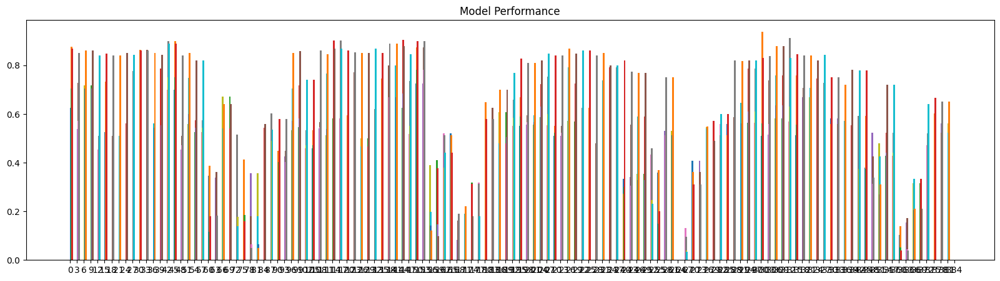

In [42]:
title = 'Model Performance'
width = 0.15

plt.figure(figsize=(20, 5))
plt.title(title)

x = 0
x_tick = [x]
for i in summary.index:
	plt.bar(x, summary.loc[i, 'recall_score'], align='edge')
	plt.bar(x + width * 1, summary.loc[i, 'precision_score'], align='edge')
	plt.bar(x + width * 2, summary.loc[i, 'f1_score'], align='edge')
	plt.bar(x + width * 3, summary.loc[i, 'accuracy'], align='edge')
	x += 3
	x_tick.append(x)

plt.xticks(x_tick)


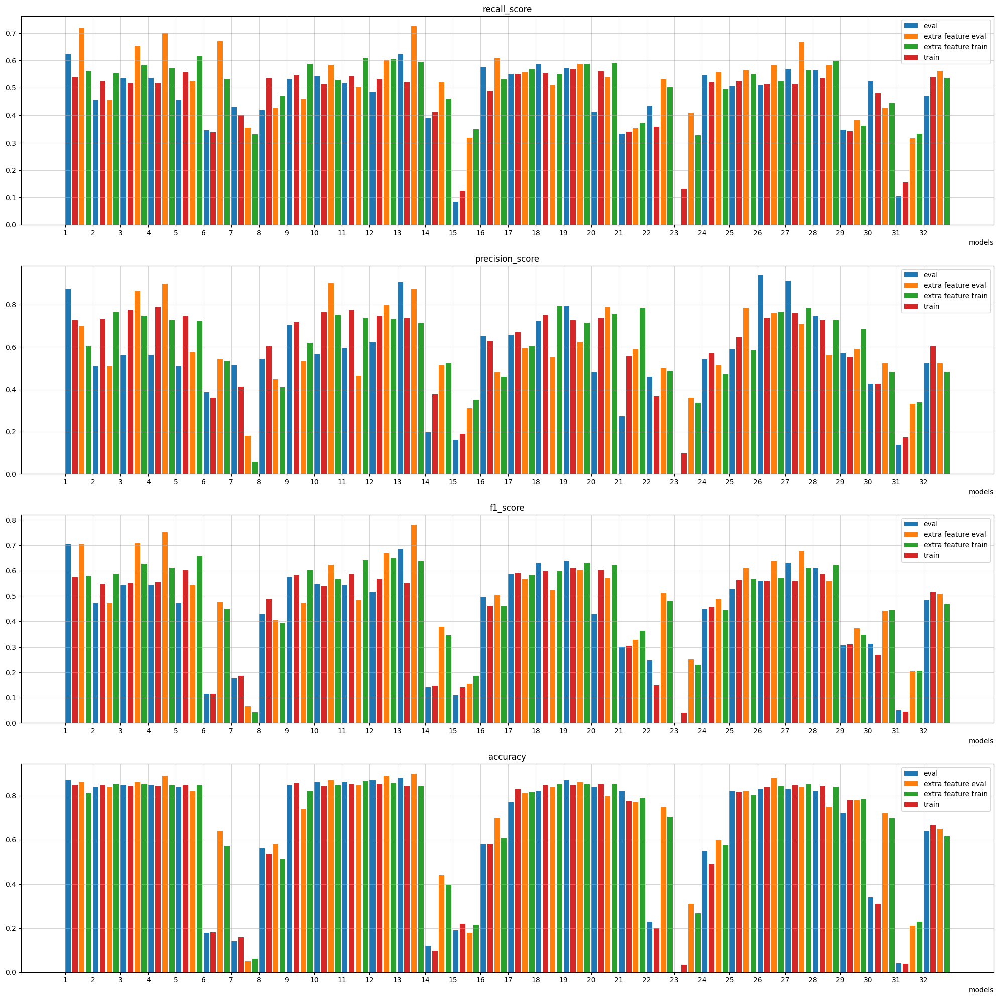

In [147]:
title = "Model Performance"

fig, axes = plt.subplots(4, 1, figsize=(20, 20))

x = 0
# _ = None

sub_titles = ['recall_score', 'precision_score', 'f1_score', 'accuracy']

models = []
for i in range(len(sub_titles)):
	for t, sub_table in summary.groupby('type'):
		# print(sub_table.shape)
		# _ = sub_table
		axes[i].bar(sub_table.index + 1, sub_table[sub_titles[i]], label=t, align='edge')
		# axes[0].plot(sub_table['accuracy'], label=t)
		axes[i].set_title(sub_titles[i])
		axes[i].set_xticks(sub_table.index, range(1, 1+len(sub_table.index)))
		axes[i].set_xlabel('models',  position=(1, 0), ha='right')
		axes[i].legend()
		axes[i].grid('--', alpha=0.5)
		x += 1
		models.append(sub_table['model'])
		
plt.tight_layout()
plt.savefig(output + f'/img/{title}.png')

In [151]:
models[0].reset_index(drop=True).to_csv(output + '/models.csv')

In [118]:
models[1]

2      CountVectorizer()-SelectKBest(k=20, score_func...
6      CountVectorizer()-SelectKBest(k=20, score_func...
10     CountVectorizer()-SelectKBest(k=20, score_func...
14     CountVectorizer()-SelectKBest(k=20, score_func...
18     CountVectorizer()-SelectKBest(k=20, score_func...
22     CountVectorizer()-SelectKBest(k=20, score_func...
26     CountVectorizer()-SelectKBest(k=20, score_func...
30     CountVectorizer()-SelectKBest(k=20, score_func...
34     CountVectorizer()-SelectKBest(k=20, score_func...
38     CountVectorizer()-SelectKBest(k=20, score_func...
42     CountVectorizer()-SelectKBest(k=20, score_func...
46     CountVectorizer()-SelectKBest(k=20, score_func...
50     CountVectorizer()-SelectKBest(k=20, score_func...
54     CountVectorizer()-SelectKBest(k=20, score_func...
58     CountVectorizer()-SelectKBest(k=20, score_func...
62     CountVectorizer()-SelectKBest(k=20, score_func...
66     TfidfVectorizer()-SelectKBest(k=20, score_func...
70     TfidfVectorizer()-Select

In [67]:
summary['type'].value_counts()

type
metrics-eval                   32
metrics-train                  32
metrics-extra feature eval     32
metrics-extra feature train    32
Name: count, dtype: int64

In [70]:
summary['model'].value_counts()

model
CountVectorizer()-SelectKBest(k=20, score_func=chi2)-DecisionTreeClassifier()-[recall_score, precision_score, f1_score]                                        4
CountVectorizer()-SelectKBest(k=20, score_func=chi2)-LinearSVC()-[recall_score, precision_score, f1_score]                                                     4
TfidfVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-NuSVC(kernel='sigmoid', nu=0.1)-[recall_score, precision_score, f1_score]                  4
TfidfVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-NuSVC(kernel='poly', nu=0.1)-[recall_score, precision_score, f1_score]                     4
TfidfVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-MultinomialNB()-[recall_score, precision_score, f1_score]                                  4
TfidfVectorizer()-SelectKBest(k=20, score_func=mutual_info_classif)-MLPClassifier(hidden_layer_sizes=(60, 20, 8))-[recall_score, precision_score, f1_score]    4
TfidfVectorizer()-SelectKBes

In [81]:
_

,model,type,recall_score,precision_score,f1_score,accuracy
0,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.625103,0.875926,0.704127,0.87
4,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.454321,0.511111,0.470760,0.84
8,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.537281,0.561869,0.542973,0.85
12,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.537281,0.561869,0.542973,0.85
16,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.454321,0.511111,0.470760,0.84
20,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.345679,0.386525,0.115553,0.18
24,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.428807,0.515326,0.177572,0.14
28,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.418313,0.544872,0.427785,0.56
32,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.533333,0.705556,0.572549,0.85
36,"CountVectorizer()-SelectKBest(k=20, score_func...",metrics-eval,0.541667,0.565657,0.547038,0.86
